In [1]:
import zipfile
import os
import shutil
import ultralytics
from ultralytics import YOLO
import torch
import cv2
import numpy as np
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.predict import get_prediction, get_sliced_prediction
from IPython.display import Image

#Inputs
working_directory="C:/Users/Pheno/Documents/database_almondcv2/"
raw_folder="C:/Users/Pheno/Documents/database_almondcv2/all_sessions/"
chessboards="C:/Users/Pheno/Documents/database_almondcv2/calibracion/chessboards"
mtx_input_path=os.path.join(chessboards,"calibration_mtx.npz") ## for distorsion
standard_matrix_color="C:/Users/Pheno/Documents/database_almondcv2/all_sessions/02_11_F-010.JPG" ### a picture to select if some pictures produces errors in color 
info_data="C:/Users/Pheno/Documents/database_almondcv2/info_data.txt"
#outputs
output="C:/Users/Pheno/Documents/database_almondcv2"
output_calibrated=os.path.join(output,"calibrated_pics/")
os.makedirs(output_calibrated, exist_ok=True)


In [2]:

def train_model(working_directory,input_zip):
    input_zip_no_extension, extension=os.path.splitext(input_zip)
    output_folder=os.path.join(working_directory,input_zip_no_extension)
        # Verificar si la carpeta ya existe
    if os.path.exists(output_folder):
    # Si existe, eliminar todo el contenido
        shutil.rmtree(output_folder)
    os.makedirs(output_folder, exist_ok=True)
    zip_file_path=os.path.join(working_directory,input_zip)
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(output_folder)
    


    


In [41]:
train_model(working_directory=working_directory, input_zip="slices_coin_02102024.zip")


In [40]:
import yaml

def modify_yaml(input_folder: str, yaml_file: str):
    # Leer el archivo YAML
    with open(yaml_file, 'r') as file:
        data = yaml.safe_load(file)

    # Crear un nuevo diccionario para los datos modificados
    modified_data = {
        'path': input_folder,  # Cambiar 'path' a la primera fila
        'train': 'images/Train',  # Borrar referencia a Train.txt
        'val': 'images/Validation',  # Borrar referencia a Validation.txt
        'test': 'images/Test'  # Borrar referencia a Test.txt
    }
    
    # Agregar 'names' al final
    if 'names' in data:
        modified_data['names'] = data['names']

    # Escribir de nuevo el archivo YAML
    with open(yaml_file, 'w') as file:
        yaml.dump(modified_data, file, default_flow_style=False)




In [42]:
# Uso de la función
input_folder = os.path.join(working_directory,"slices_coin_02102024") # Cambia esto a la ruta deseada
yaml_file = os.path.join(working_directory,"slices_coin_02102024","data.yaml") # Cambia esto al nombre de tu archivo YAML
modify_yaml(input_folder, yaml_file)

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
if torch.cuda.is_available():
    # Obtener el índice del dispositivo actual
    gpu_index = torch.cuda.current_device()

    # Obtener el nombre de la GPU
    gpu_name = torch.cuda.get_device_name(gpu_index)

    # Obtener la memoria total de la GPU
    gpu_memory = torch.cuda.get_device_properties(gpu_index).total_memory

    # Convertir la memoria de bytes a gigabytes
    gpu_memory_gb = gpu_memory / (1024 ** 3)

    # Imprimir las características de la GPU
    print(f"GPU detectada: {gpu_name}")
    print(f"Memoria total de la GPU: {gpu_memory_gb:.2f} GB")
else:
    print("No se detectó ninguna GPU. Usando CPU.")
# ultralytics.checks()


GPU detectada: NVIDIA GeForce RTX 3060
Memoria total de la GPU: 12.00 GB


In [23]:
results_models_directory=os.path.join(working_directory,"results_models_segmentation")
os.makedirs(results_models_directory, exist_ok=True)

In [ ]:

model = YOLO('yolov8n-seg.pt')  # load a pretrained model (recommended for training)
model.to(device)
path_yaml=os.path.join(working_directory,"slices_coin_02102024","data.yaml")
model.train(data=path_yaml, epochs=100, imgsz=1280,batch=-1, project=results_models_directory)

In [46]:
# Run batched inference on a list of images
model = YOLO("C:/Users/Pheno/Documents/database_almondcv2/train4/weights/last.pt")
model.to(device)
input_folder="C:/Users/Pheno/Documents/database_almondcv2/slices_coin_02102024/images/Test/"
#results devuelve una lista por foto, con una lista de arrays con las coordenadas de cada uno de los objetos segmentados.
results = model.predict(input_folder, imgsz=1280, show= False, save=True, show_boxes=False, project=results_models_directory, save_txt=True)



image 1/96 C:\Users\Pheno\Documents\database_almondcv2\slices_coin_02102024\images\Test\SL_CL_17_11_F-010_0_0_1280_1280.png: 1280x1280 (no detections), 15.5ms
image 2/96 C:\Users\Pheno\Documents\database_almondcv2\slices_coin_02102024\images\Test\SL_CL_17_11_F-010_0_1024_1280_2304.png: 1280x1280 1 coin, 16.0ms
image 3/96 C:\Users\Pheno\Documents\database_almondcv2\slices_coin_02102024\images\Test\SL_CL_17_11_F-010_0_2048_1280_3328.png: 1280x1280 (no detections), 13.0ms
image 4/96 C:\Users\Pheno\Documents\database_almondcv2\slices_coin_02102024\images\Test\SL_CL_17_11_F-010_0_2334_1280_3614.png: 1280x1280 (no detections), 12.0ms
image 5/96 C:\Users\Pheno\Documents\database_almondcv2\slices_coin_02102024\images\Test\SL_CL_17_11_F-010_1024_0_2304_1280.png: 1280x1280 (no detections), 16.0ms
image 6/96 C:\Users\Pheno\Documents\database_almondcv2\slices_coin_02102024\images\Test\SL_CL_17_11_F-010_1024_1024_2304_2304.png: 1280x1280 1 coin, 16.0ms
image 7/96 C:\Users\Pheno\Documents\database_

In [50]:
results[1].path

'C:\\Users\\Pheno\\Documents\\database_almondcv2\\slices_coin_02102024\\images\\Test\\SL_CL_17_11_F-010_0_1024_1280_2304.png'

In [68]:
results[1].masks.xy[0].shape

(164, 2)

In [45]:

contours_yolo=results[1].masks.xy[0]
contour_pixels = contours_yolo.astype(np.int32)
contour_opencv = contour_pixels.reshape((-1, 1, 2))
# Calcular el área del contorno
area = cv2.contourArea(contour_opencv)
print(area)

image = cv2.imread('C:/Users/Pheno/Documents/database_almondcv2/slices_coin_02102024/images/Validation/SL_CL_02_11_F-022_0_1024_1280_2304.png')
cv2.drawContours(image, [contour_opencv], -1, (0, 255, 0), 2)
cv2.imshow('Image with Contour', image)
cv2.waitKey(0)
cv2.destroyAllWindows()

19490.0


In [74]:
# Ahora vamos a tratar de utilizar SAHI para aplicarlo sobre las imagenes completas calibradas
yolov8_seg_model_path = "C:/Users/Pheno/Documents/database_almondcv2/train4/weights/last.pt"
detection_model_seg = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=yolov8_seg_model_path,
    confidence_threshold=0.3,
    device=device, # or 'cuda:0'
)



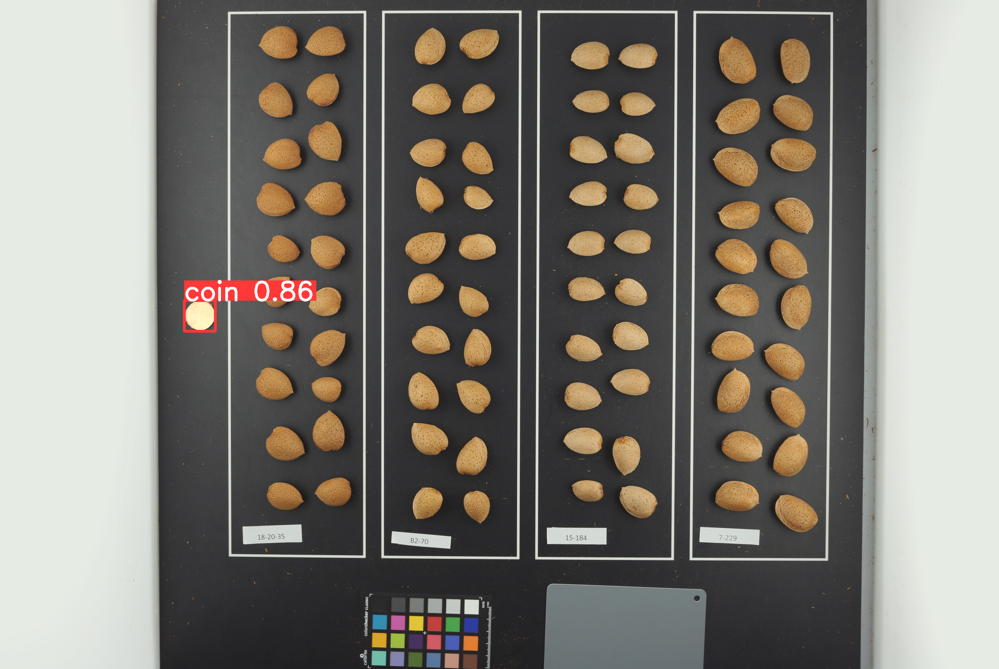

In [75]:
im = read_image("C:/Users/Pheno/Documents/database_almondcv2/calibrated_pics/CL_02_11_F-045.JPG")
h = im.shape[0]
w = im.shape[1]

result = get_prediction("C:/Users/Pheno/Documents/database_almondcv2/calibrated_pics/CL_02_11_F-045.JPG", detection_model_seg, full_shape=(h, w))
result.export_visuals(export_dir="C:/Users/Pheno/Documents/database_almondcv2/")
Image("C:/Users/Pheno/Documents/database_almondcv2/prediction_visual.png")

Performing prediction on 126 slices.


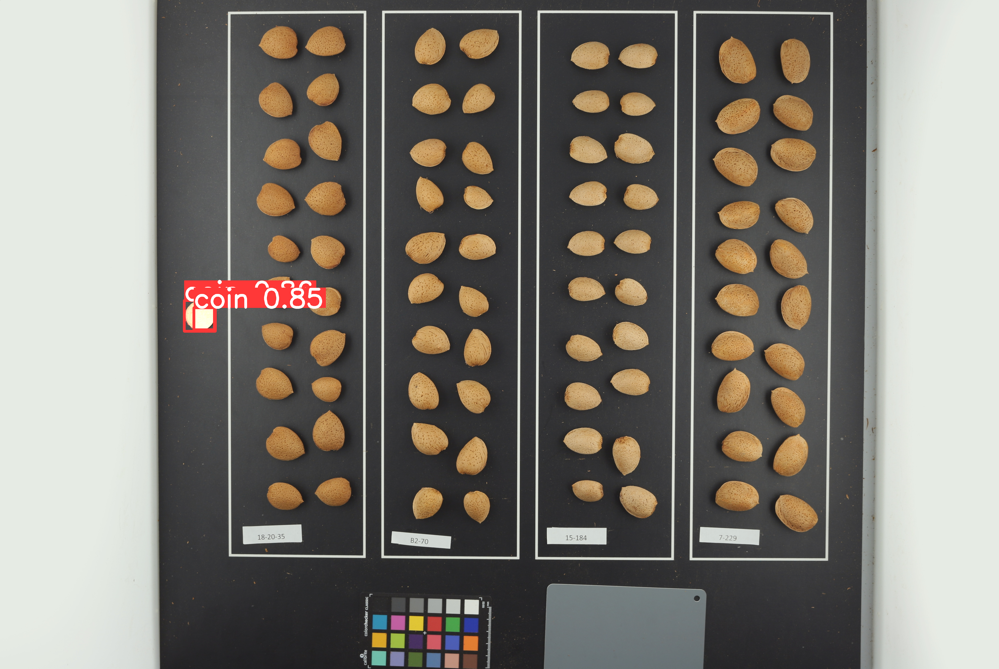

In [83]:
result = get_sliced_prediction(
    "C:/Users/Pheno/Documents/database_almondcv2/calibrated_pics/CL_02_11_F-045.JPG",
    detection_model_seg,
    slice_height = 640,
    slice_width = 640,
    overlap_height_ratio = 0.4,
    overlap_width_ratio = 0.4
)

result.export_visuals(export_dir="C:/Users/Pheno/Documents/database_almondcv2/")

Image("C:/Users/Pheno/Documents/database_almondcv2/prediction_visual.png")

In [3]:
object_prediction_list = result.object_prediction_list
object_prediction_list[0]

NameError: name 'result' is not defined

In [85]:
array_contour=np.array(object_prediction_list[0].mask.segmentation[0])
array_contour=array_contour.reshape(-1,2)
array_contour

array([[1016, 1660],
       [1016, 1661],
       [1014, 1661],
       [1013, 1662],
       [1013, 1664],
       [1012, 1664],
       [1012, 1666],
       [1010, 1668],
       [1010, 1669],
       [1009, 1670],
       [1008, 1671],
       [1008, 1672],
       [1007, 1673],
       [1006, 1673],
       [1005, 1674],
       [1005, 1675],
       [1003, 1677],
       [1002, 1677],
       [1000, 1679],
       [1000, 1681],
       [ 999, 1682],
       [ 997, 1682],
       [ 996, 1683],
       [ 997, 1684],
       [ 996, 1685],
       [ 997, 1686],
       [ 996, 1687],
       [ 996, 1689],
       [ 997, 1690],
       [ 996, 1691],
       [ 996, 1692],
       [ 997, 1693],
       [ 997, 1694],
       [ 996, 1695],
       [ 996, 1696],
       [ 997, 1697],
       [ 996, 1698],
       [ 997, 1699],
       [ 996, 1700],
       [ 997, 1701],
       [ 996, 1702],
       [ 997, 1703],
       [ 996, 1704],
       [ 997, 1705],
       [ 996, 1706],
       [ 997, 1707],
       [ 996, 1708],
       [ 997,

In [86]:

contours_yolo=array_contour
contour_pixels = contours_yolo.astype(np.int32)
contour_opencv = contour_pixels.reshape((-1, 1, 2))
# Calcular el área del contorno
area = cv2.contourArea(contour_opencv)
print(area)

image = cv2.imread('C:/Users/Pheno/Documents/database_almondcv2/calibrated_pics/CL_02_11_F-045.JPG')
cv2.drawContours(image, [contour_opencv], -1, (0, 255, 0), 2)
cv2.imshow('Image with Contour', image)
cv2.waitKey(0)
cv2.destroyAllWindows()
output_path = 'C:/Users/Pheno/Documents/database_almondcv2/contour_image.jpg'  # Cambia el nombre si es necesario
cv2.imwrite(output_path, image)

21183.5


True

In [65]:
object_prediction_list[0].mask.segmentation[0]

[1045,
 1632,
 1044,
 1633,
 1044,
 1634,
 1042,
 1636,
 1037,
 1636,
 1036,
 1637,
 1036,
 1638,
 1034,
 1640,
 1033,
 1640,
 1032,
 1641,
 1032,
 1642,
 1030,
 1644,
 1029,
 1644,
 1028,
 1645,
 1025,
 1648,
 1024,
 1648,
 1024,
 1649,
 1024,
 1650,
 1022,
 1652,
 1021,
 1652,
 1020,
 1653,
 1020,
 1654,
 1018,
 1656,
 1017,
 1656,
 1016,
 1657,
 1016,
 1660,
 1015,
 1661,
 1014,
 1661,
 1013,
 1662,
 1013,
 1664,
 1012,
 1665,
 1012,
 1666,
 1011,
 1667,
 1011,
 1668,
 1010,
 1669,
 1009,
 1669,
 1009,
 1670,
 1009,
 1671,
 1008,
 1672,
 1007,
 1673,
 1006,
 1673,
 1005,
 1674,
 1005,
 1675,
 1003,
 1677,
 1002,
 1677,
 1000,
 1679,
 1000,
 1681,
 999,
 1682,
 997,
 1682,
 996,
 1683,
 997,
 1684,
 996,
 1685,
 997,
 1686,
 996,
 1687,
 996,
 1689,
 997,
 1690,
 996,
 1691,
 996,
 1692,
 997,
 1693,
 997,
 1694,
 996,
 1695,
 996,
 1696,
 997,
 1697,
 996,
 1698,
 997,
 1699,
 996,
 1700,
 997,
 1701,
 996,
 1702,
 997,
 1703,
 996,
 1704,
 997,
 1705,
 996,
 1706,
 997,
 1707,
 996